# Implementing a Neural Network
In this exercise we will develop a neural network with fully-connected layers to perform classification, and test it out on the CIFAR-10 dataset.

In [4]:
# A bit of setup

import numpy as np
import matplotlib.pyplot as plt

from cs231n.classifiers.neural_net import TwoLayerNet

%matplotlib inline
plt.rcParams['figure.figsize'] = (10.0, 8.0) # set default size of plots
plt.rcParams['image.interpolation'] = 'nearest'
plt.rcParams['image.cmap'] = 'gray'

# for auto-reloading external modules
# see http://stackoverflow.com/questions/1907993/autoreload-of-modules-in-ipython
%load_ext autoreload
%autoreload 2

def rel_error(x, y):
  """ returns relative error """
  return np.max(np.abs(x - y) / (np.maximum(1e-8, np.abs(x) + np.abs(y))))

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


We will use the class `TwoLayerNet` in the file `cs231n/classifiers/neural_net.py` to represent instances of our network. The network parameters are stored in the instance variable `self.params` where keys are string parameter names and values are numpy arrays. Below, we initialize toy data and a toy model that we will use to develop your implementation.

In [5]:
# Create a small net and some toy data to check your implementations.
# Note that we set the random seed for repeatable experiments.

input_size = 4
hidden_size = 10
num_classes = 3
num_inputs = 5

def init_toy_model():
  np.random.seed(0)
  return TwoLayerNet(input_size, hidden_size, num_classes, std=1e-1)

def init_toy_data():
  np.random.seed(1)
  X = 10 * np.random.randn(num_inputs, input_size)
  y = np.array([0, 1, 2, 2, 1])
  return X, y

net = init_toy_model()
X, y = init_toy_data()

# Forward pass: compute scores
Open the file `cs231n/classifiers/neural_net.py` and look at the method `TwoLayerNet.loss`. This function is very similar to the loss functions you have written for the SVM and Softmax exercises: It takes the data and weights and computes the class scores, the loss, and the gradients on the parameters. 

Implement the first part of the forward pass which uses the weights and biases to compute the scores for all inputs.

In [7]:
scores = net.loss(X)
print('Your scores:')
print(scores)
print()
print('correct scores:')
correct_scores = np.asarray([
  [-0.81233741, -1.27654624, -0.70335995],
  [-0.17129677, -1.18803311, -0.47310444],
  [-0.51590475, -1.01354314, -0.8504215 ],
  [-0.15419291, -0.48629638, -0.52901952],
  [-0.00618733, -0.12435261, -0.15226949]])
print(correct_scores)
print()
# The difference should be very small. We get < 1e-7
print('Difference between your scores and correct scores:')
print(np.sum(np.abs(scores - correct_scores)))

Your scores:
[[-0.81233741 -1.27654624 -0.70335995]
 [-0.17129677 -1.18803311 -0.47310444]
 [-0.51590475 -1.01354314 -0.8504215 ]
 [-0.15419291 -0.48629638 -0.52901952]
 [-0.00618733 -0.12435261 -0.15226949]]

correct scores:
[[-0.81233741 -1.27654624 -0.70335995]
 [-0.17129677 -1.18803311 -0.47310444]
 [-0.51590475 -1.01354314 -0.8504215 ]
 [-0.15419291 -0.48629638 -0.52901952]
 [-0.00618733 -0.12435261 -0.15226949]]

Difference between your scores and correct scores:
3.68027207103e-08


# Forward pass: compute loss
In the same function, implement the second part that computes the data and regularizaion loss.

In [8]:
loss, _ = net.loss(X, y, reg=0.1)
correct_loss = 1.30378789133

# should be very small, we get < 1e-12
print('Difference between your loss and correct loss:')
print(np.sum(np.abs(loss - correct_loss)))

Difference between your loss and correct loss:
1.79412040779e-13


# Backward pass
Implement the rest of the function. This will compute the gradient of the loss with respect to the variables `W1`, `b1`, `W2`, and `b2`. Now that you (hopefully!) have a correctly implemented forward pass, you can debug your backward pass using a numeric gradient check:

In [9]:
from cs231n.gradient_check import eval_numerical_gradient

# Use numeric gradient checking to check your implementation of the backward pass.
# If your implementation is correct, the difference between the numeric and
# analytic gradients should be less than 1e-8 for each of W1, W2, b1, and b2.

loss, grads = net.loss(X, y, reg=0.1)

# these should all be less than 1e-8 or so
for param_name in grads:
  f = lambda W: net.loss(X, y, reg=0.1)[0]
  param_grad_num = eval_numerical_gradient(f, net.params[param_name], verbose=False)
  print('%s max relative error: %e' % (param_name, rel_error(param_grad_num, grads[param_name])))

W2 max relative error: 3.440708e-09
W1 max relative error: 3.669858e-09
b1 max relative error: 2.738422e-09
b2 max relative error: 4.447698e-11


# Train the network
To train the network we will use stochastic gradient descent (SGD), similar to the SVM and Softmax classifiers. Look at the function `TwoLayerNet.train` and fill in the missing sections to implement the training procedure. This should be very similar to the training procedure you used for the SVM and Softmax classifiers. You will also have to implement `TwoLayerNet.predict`, as the training process periodically performs prediction to keep track of accuracy over time while the network trains.

Once you have implemented the method, run the code below to train a two-layer network on toy data. You should achieve a training loss less than 0.2.

Final training loss:  0.0156349876119


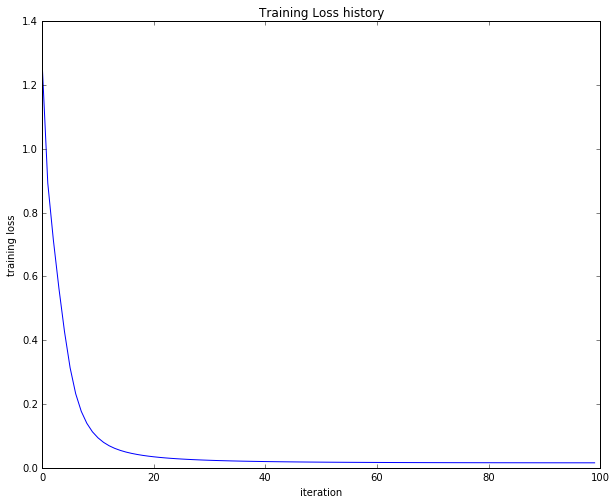

In [10]:
net = init_toy_model()
stats = net.train(X, y, X, y,
            learning_rate=1e-1, reg=1e-5,
            num_iters=100, verbose=False)

print('Final training loss: ', stats['loss_history'][-1])
# plot the loss history
plt.plot(stats['loss_history'])
plt.xlabel('iteration')
plt.ylabel('training loss')
plt.title('Training Loss history')
plt.show()

# Load the data
Now that you have implemented a two-layer network that passes gradient checks and works on toy data, it's time to load up our favorite CIFAR-10 data so we can use it to train a classifier on a real dataset.

In [11]:
from cs231n.data_utils import load_CIFAR10

def get_CIFAR10_data(num_training=49000, num_validation=1000, num_test=1000):
    """
    Load the CIFAR-10 dataset from disk and perform preprocessing to prepare
    it for the two-layer neural net classifier. These are the same steps as
    we used for the SVM, but condensed to a single function.  
    """
    # Load the raw CIFAR-10 data
    cifar10_dir = 'cs231n/datasets/cifar-10-batches-py'
    X_train, y_train, X_test, y_test = load_CIFAR10(cifar10_dir)
        
    # Subsample the data
    mask = range(num_training, num_training + num_validation)
    X_val = X_train[mask]
    y_val = y_train[mask]
    mask = range(num_training)
    X_train = X_train[mask]
    y_train = y_train[mask]
    mask = range(num_test)
    X_test = X_test[mask]
    y_test = y_test[mask]

    # Normalize the data: subtract the mean image
    mean_image = np.mean(X_train, axis=0)
    X_train -= mean_image
    X_val -= mean_image
    X_test -= mean_image

    # Reshape data to rows
    X_train = X_train.reshape(num_training, -1)
    X_val = X_val.reshape(num_validation, -1)
    X_test = X_test.reshape(num_test, -1)

    return X_train, y_train, X_val, y_val, X_test, y_test


# Invoke the above function to get our data.
X_train, y_train, X_val, y_val, X_test, y_test = get_CIFAR10_data()
print('Train data shape: ', X_train.shape)
print('Train labels shape: ', y_train.shape)
print('Validation data shape: ', X_val.shape)
print('Validation labels shape: ', y_val.shape)
print('Test data shape: ', X_test.shape)
print('Test labels shape: ', y_test.shape)

Train data shape:  (49000, 3072)
Train labels shape:  (49000,)
Validation data shape:  (1000, 3072)
Validation labels shape:  (1000,)
Test data shape:  (1000, 3072)
Test labels shape:  (1000,)


# Train a network
To train our network we will use SGD with momentum. In addition, we will adjust the learning rate with an exponential learning rate schedule as optimization proceeds; after each epoch, we will reduce the learning rate by multiplying it by a decay rate.

In [12]:
input_size = 32 * 32 * 3
hidden_size = 50
num_classes = 10
net = TwoLayerNet(input_size, hidden_size, num_classes)

# Train the network
stats = net.train(X_train, y_train, X_val, y_val,
            num_iters=1000, batch_size=200,
            learning_rate=1e-4, learning_rate_decay=0.95,
            reg=0.5, verbose=True)

# Predict on the validation set
val_acc = (net.predict(X_val) == y_val).mean()
print('Validation accuracy: ', val_acc)

iteration 0 / 1000: loss 2.302939
iteration 100 / 1000: loss 2.302427
iteration 200 / 1000: loss 2.298095
iteration 300 / 1000: loss 2.253179
iteration 400 / 1000: loss 2.152041
iteration 500 / 1000: loss 2.115062
iteration 600 / 1000: loss 2.067323
iteration 700 / 1000: loss 2.031150
iteration 800 / 1000: loss 1.968564
iteration 900 / 1000: loss 1.962258
Validation accuracy:  0.29


# Debug the training
With the default parameters we provided above, you should get a validation accuracy of about 0.29 on the validation set. This isn't very good.

One strategy for getting insight into what's wrong is to plot the loss function and the accuracies on the training and validation sets during optimization.

Another strategy is to visualize the weights that were learned in the first layer of the network. In most neural networks trained on visual data, the first layer weights typically show some visible structure when visualized.

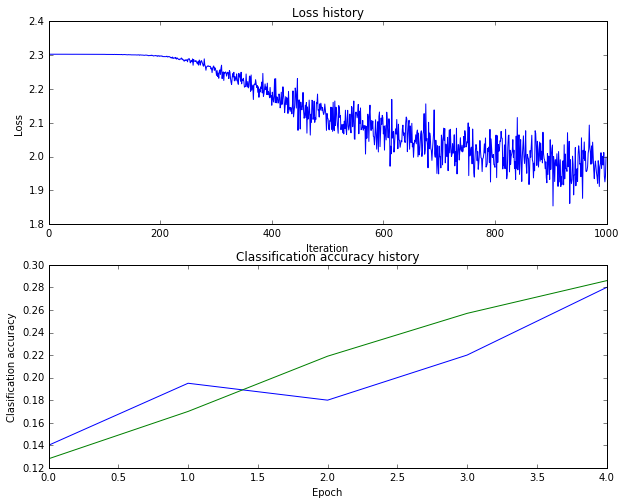

In [13]:
# Plot the loss function and train / validation accuracies
plt.subplot(2, 1, 1)
plt.plot(stats['loss_history'])
plt.title('Loss history')
plt.xlabel('Iteration')
plt.ylabel('Loss')

plt.subplot(2, 1, 2)
plt.plot(stats['train_acc_history'], label='train')
plt.plot(stats['val_acc_history'], label='val')
plt.title('Classification accuracy history')
plt.xlabel('Epoch')
plt.ylabel('Clasification accuracy')
plt.show()

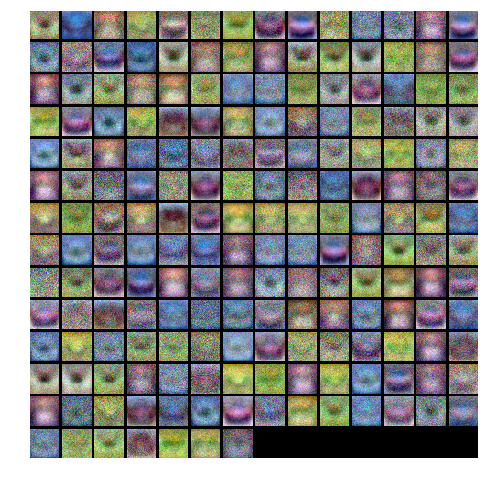

In [20]:
from cs231n.vis_utils import visualize_grid

# Visualize the weights of the network

def show_net_weights(net):
  W1 = net.params['W1']
  W1 = W1.reshape(32, 32, 3, -1).transpose(3, 0, 1, 2)
  plt.imshow(visualize_grid(W1, padding=3).astype('uint8'))
  plt.gca().axis('off')
  plt.show()

show_net_weights(net)

# Tune your hyperparameters

**What's wrong?**. Looking at the visualizations above, we see that the loss is decreasing more or less linearly, which seems to suggest that the learning rate may be too low. Moreover, there is no gap between the training and validation accuracy, suggesting that the model we used has low capacity, and that we should increase its size. On the other hand, with a very large model we would expect to see more overfitting, which would manifest itself as a very large gap between the training and validation accuracy.

**Tuning**. Tuning the hyperparameters and developing intuition for how they affect the final performance is a large part of using Neural Networks, so we want you to get a lot of practice. Below, you should experiment with different values of the various hyperparameters, including hidden layer size, learning rate, numer of training epochs, and regularization strength. You might also consider tuning the learning rate decay, but you should be able to get good performance using the default value.

**Approximate results**. You should be aim to achieve a classification accuracy of greater than 48% on the validation set. Our best network gets over 52% on the validation set.

**Experiment**: You goal in this exercise is to get as good of a result on CIFAR-10 as you can, with a fully-connected Neural Network. For every 1% above 52% on the Test set we will award you with one extra bonus point. Feel free implement your own techniques (e.g. PCA to reduce dimensionality, or adding dropout, or adding features to the solver, etc.).

hidden_size:  50.0
learning_rate:  0.0001
iteration 0 / 700: loss 2.302951
iteration 100 / 700: loss 2.302420
iteration 200 / 700: loss 2.298879
iteration 300 / 700: loss 2.274226
iteration 400 / 700: loss 2.200549
iteration 500 / 700: loss 2.141731
iteration 600 / 700: loss 2.087401


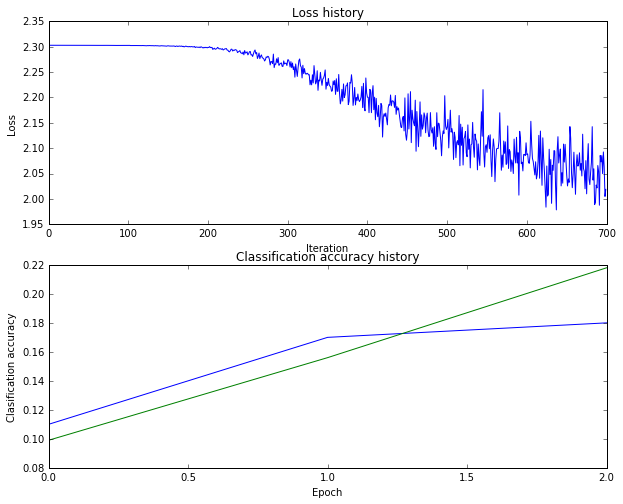

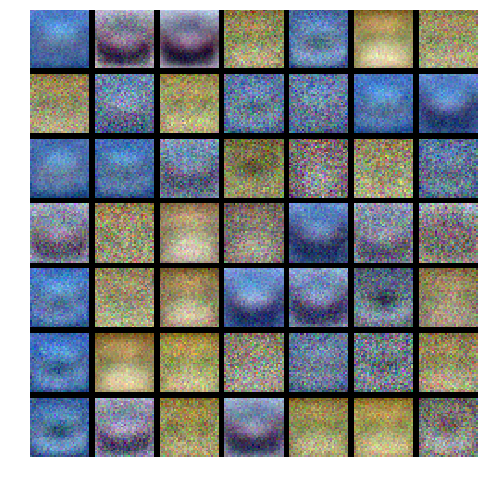


hidden_size:  50.0
learning_rate:  0.000547722557505
iteration 0 / 700: loss 2.302962
iteration 100 / 700: loss 2.152607
iteration 200 / 700: loss 1.929104
iteration 300 / 700: loss 1.852093
iteration 400 / 700: loss 1.824017
iteration 500 / 700: loss 1.692018
iteration 600 / 700: loss 1.615582


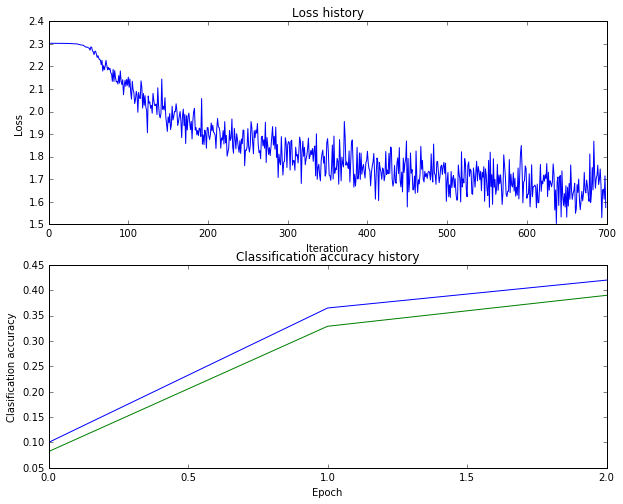

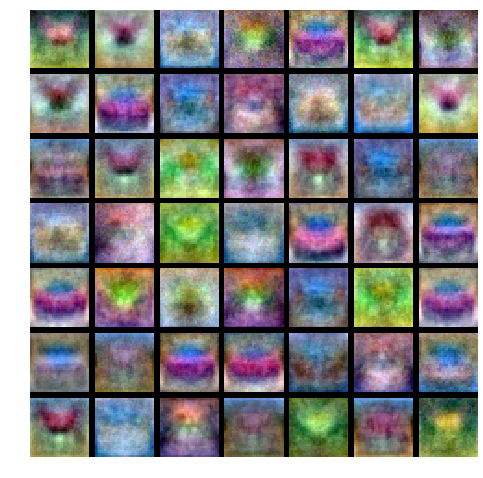


hidden_size:  50.0
learning_rate:  0.003
iteration 0 / 700: loss 2.302964
iteration 100 / 700: loss 1.782299
iteration 200 / 700: loss 1.759917
iteration 300 / 700: loss 1.680280
iteration 400 / 700: loss 1.701146
iteration 500 / 700: loss 1.553073
iteration 600 / 700: loss 1.812079


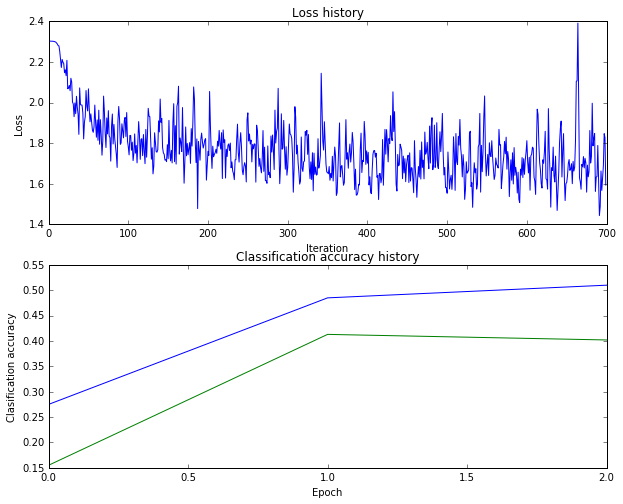

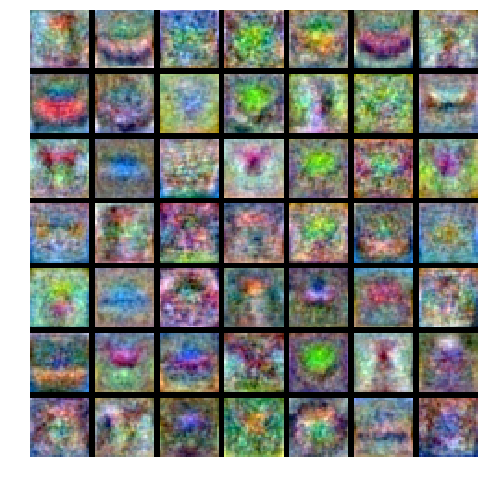


hidden_size:  69.7475396981
learning_rate:  0.0001
iteration 0 / 700: loss 2.303120
iteration 100 / 700: loss 2.302089
iteration 200 / 700: loss 2.286624
iteration 300 / 700: loss 2.259127
iteration 400 / 700: loss 2.154180
iteration 500 / 700: loss 2.118944
iteration 600 / 700: loss 2.124748


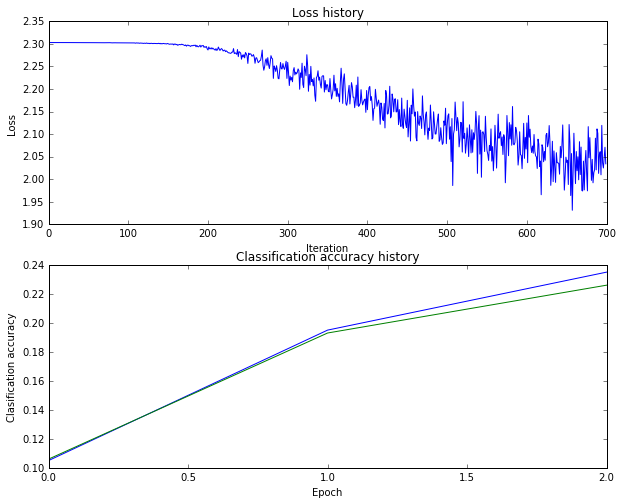

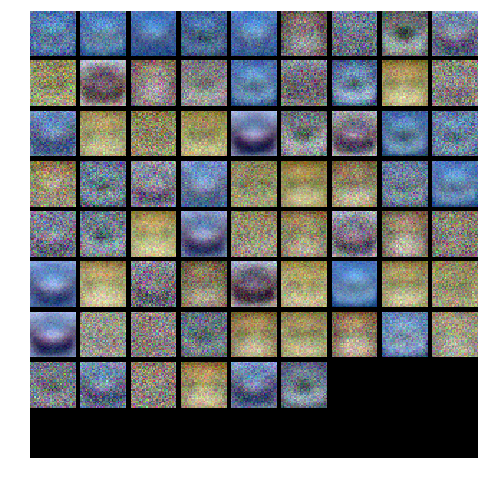


hidden_size:  69.7475396981
learning_rate:  0.000547722557505
iteration 0 / 700: loss 2.303188
iteration 100 / 700: loss 2.095101
iteration 200 / 700: loss 1.862809
iteration 300 / 700: loss 1.843826
iteration 400 / 700: loss 1.633597
iteration 500 / 700: loss 1.607204
iteration 600 / 700: loss 1.724354


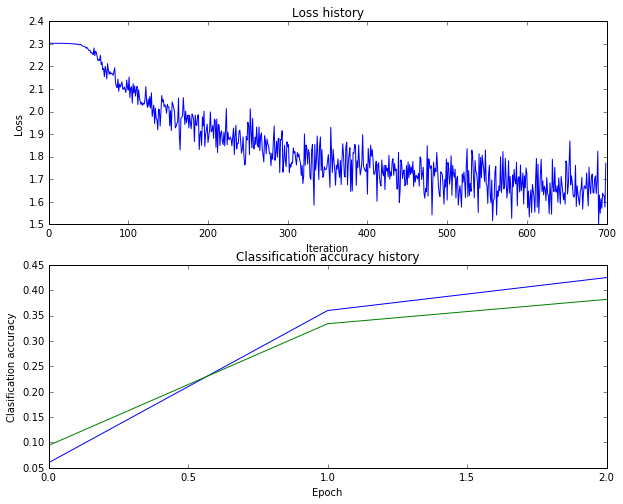

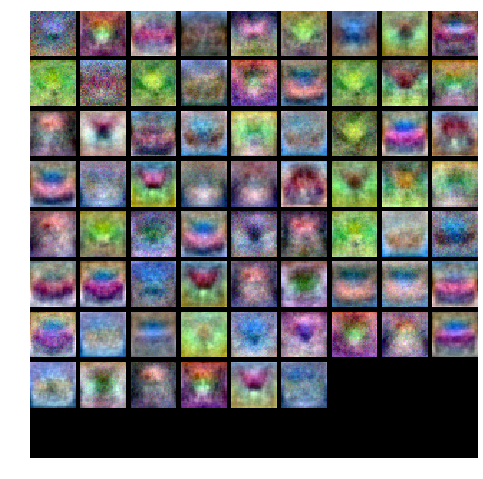


hidden_size:  69.7475396981
learning_rate:  0.003
iteration 0 / 700: loss 2.303131
iteration 100 / 700: loss 1.899344
iteration 200 / 700: loss 1.501040
iteration 300 / 700: loss 1.832850
iteration 400 / 700: loss 1.546777
iteration 500 / 700: loss 1.790923
iteration 600 / 700: loss 1.732984


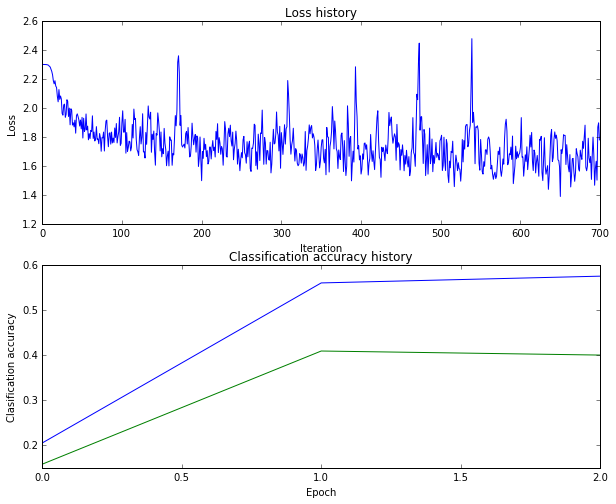

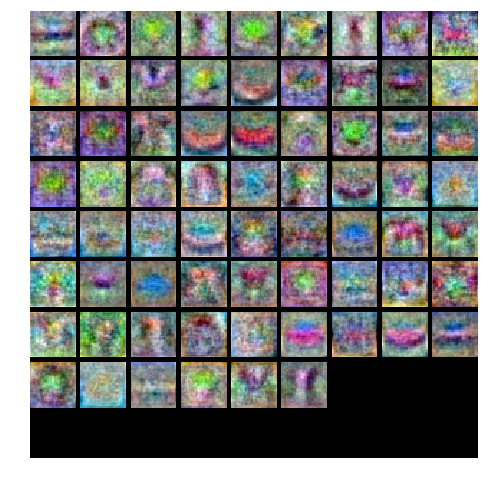


hidden_size:  97.2943858788
learning_rate:  0.0001
iteration 0 / 700: loss 2.303359
iteration 100 / 700: loss 2.302405
iteration 200 / 700: loss 2.297095
iteration 300 / 700: loss 2.256952
iteration 400 / 700: loss 2.158048
iteration 500 / 700: loss 2.121530
iteration 600 / 700: loss 2.029823


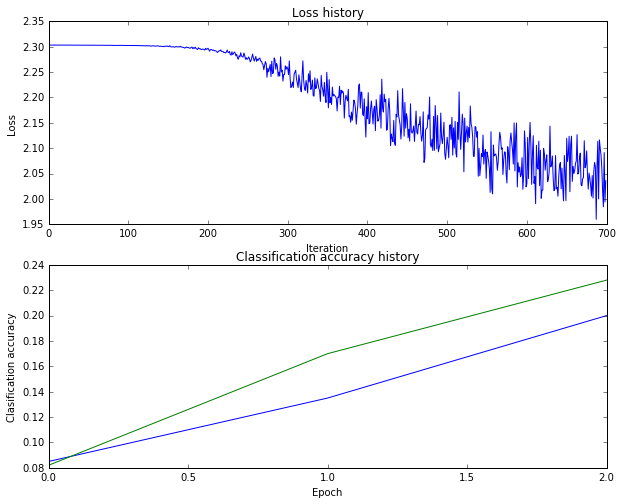

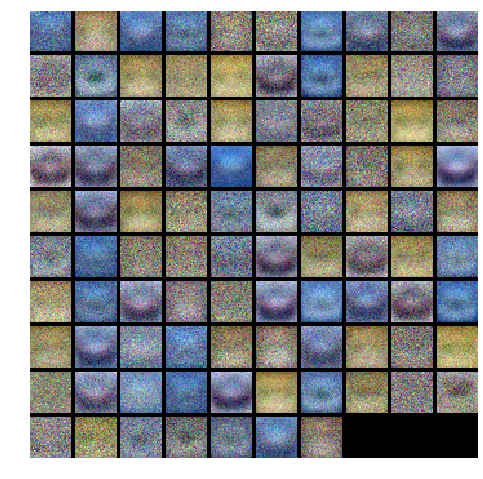


hidden_size:  97.2943858788
learning_rate:  0.000547722557505
iteration 0 / 700: loss 2.303365
iteration 100 / 700: loss 2.078236
iteration 200 / 700: loss 1.982931
iteration 300 / 700: loss 1.882638
iteration 400 / 700: loss 1.726798
iteration 500 / 700: loss 1.652528
iteration 600 / 700: loss 1.661410


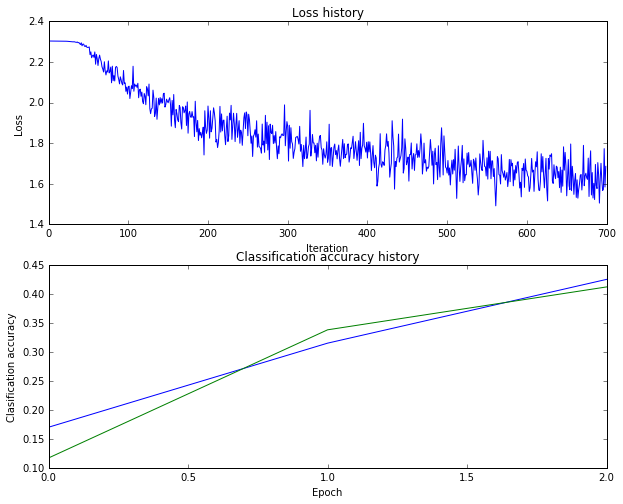

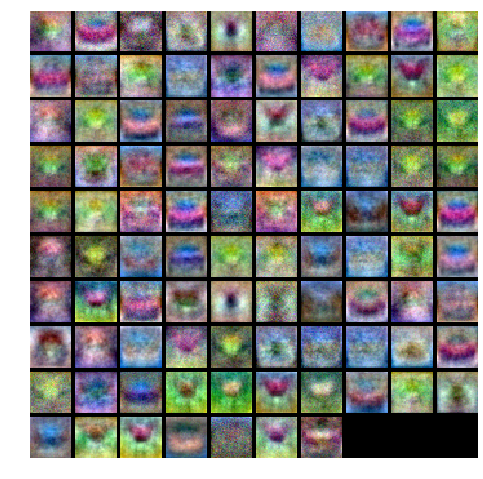


hidden_size:  97.2943858788
learning_rate:  0.003
iteration 0 / 700: loss 2.303330
iteration 100 / 700: loss 1.673215
iteration 200 / 700: loss 1.895806
iteration 300 / 700: loss 1.926765
iteration 400 / 700: loss 1.654063
iteration 500 / 700: loss 1.731545
iteration 600 / 700: loss 1.757809


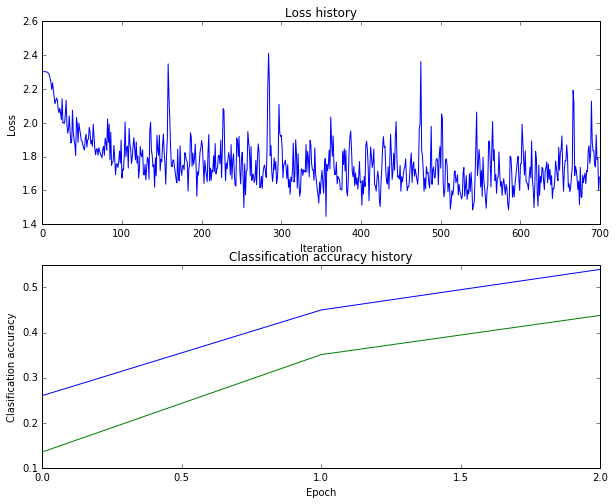

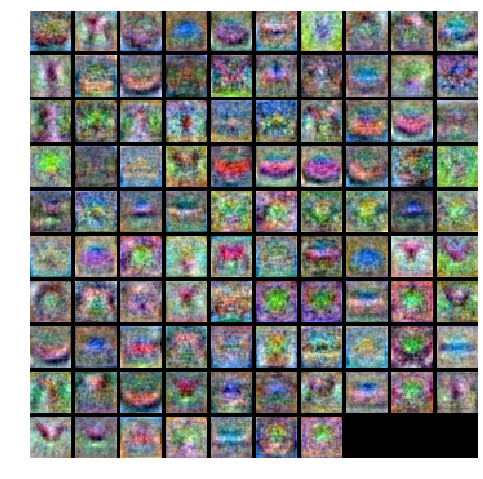


hidden_size:  135.72088083
learning_rate:  0.0001
iteration 0 / 700: loss 2.303627
iteration 100 / 700: loss 2.302129
iteration 200 / 700: loss 2.292221
iteration 300 / 700: loss 2.230514
iteration 400 / 700: loss 2.155474
iteration 500 / 700: loss 2.090131
iteration 600 / 700: loss 2.041569


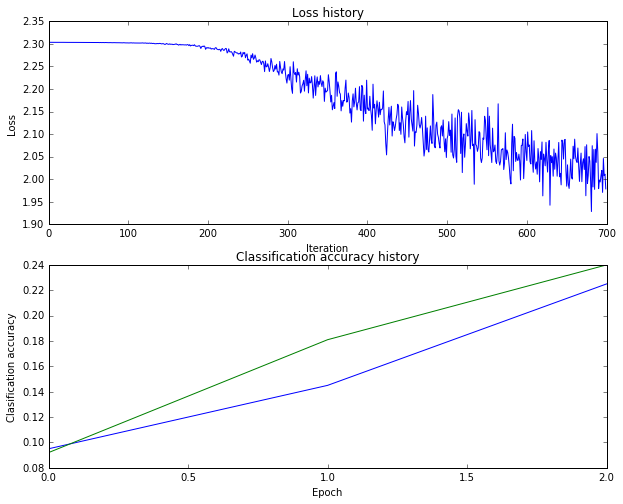

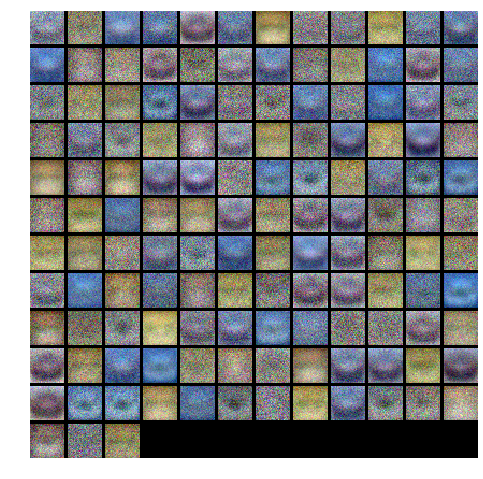


hidden_size:  135.72088083
learning_rate:  0.000547722557505
iteration 0 / 700: loss 2.303609
iteration 100 / 700: loss 2.048217
iteration 200 / 700: loss 1.892354
iteration 300 / 700: loss 1.794514
iteration 400 / 700: loss 1.745598
iteration 500 / 700: loss 1.589918
iteration 600 / 700: loss 1.648525


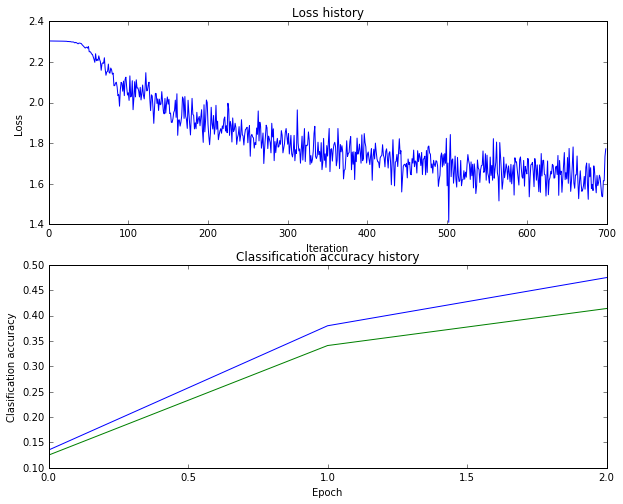

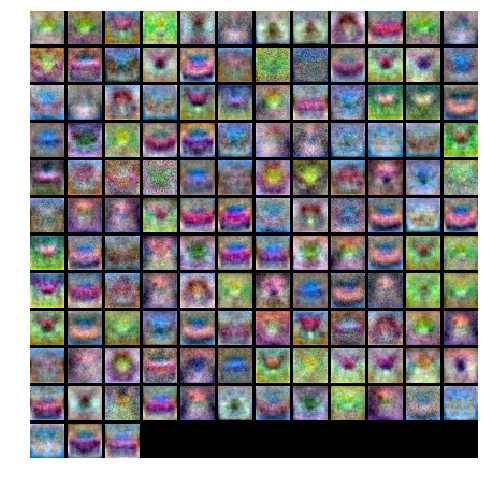


hidden_size:  135.72088083
learning_rate:  0.003
iteration 0 / 700: loss 2.303629
iteration 100 / 700: loss 1.816965
iteration 200 / 700: loss 1.719739
iteration 300 / 700: loss 1.728600
iteration 400 / 700: loss 1.590735
iteration 500 / 700: loss 1.630763
iteration 600 / 700: loss 1.836873


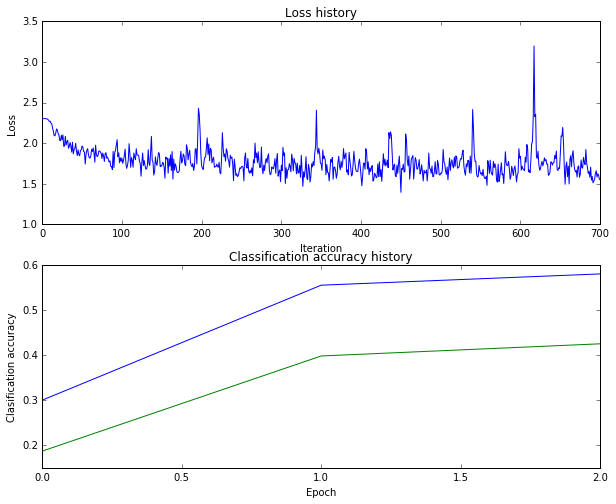

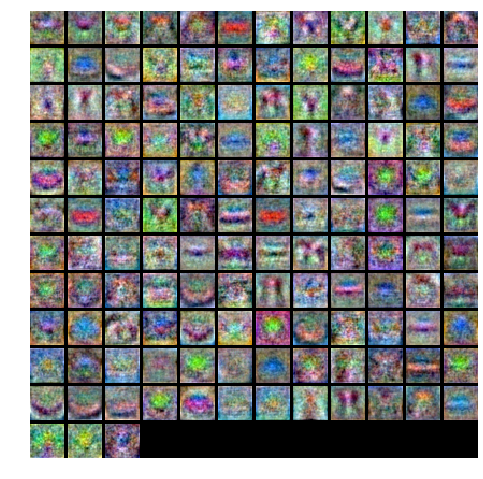


hidden_size:  189.323950471
learning_rate:  0.0001
iteration 0 / 700: loss 2.304013
iteration 100 / 700: loss 2.302900
iteration 200 / 700: loss 2.288857
iteration 300 / 700: loss 2.219773
iteration 400 / 700: loss 2.216058
iteration 500 / 700: loss 2.076662
iteration 600 / 700: loss 1.972412


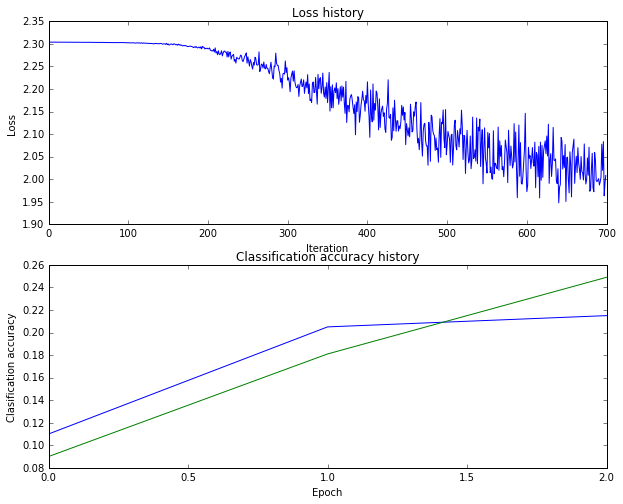

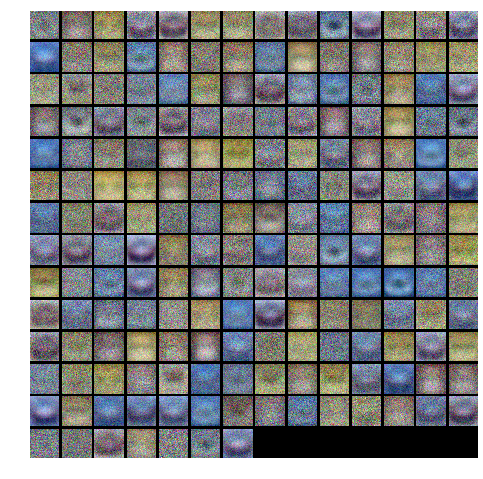


hidden_size:  189.323950471
learning_rate:  0.000547722557505
iteration 0 / 700: loss 2.304056
iteration 100 / 700: loss 2.041437
iteration 200 / 700: loss 1.892232
iteration 300 / 700: loss 1.792690
iteration 400 / 700: loss 1.741502
iteration 500 / 700: loss 1.685051
iteration 600 / 700: loss 1.657290


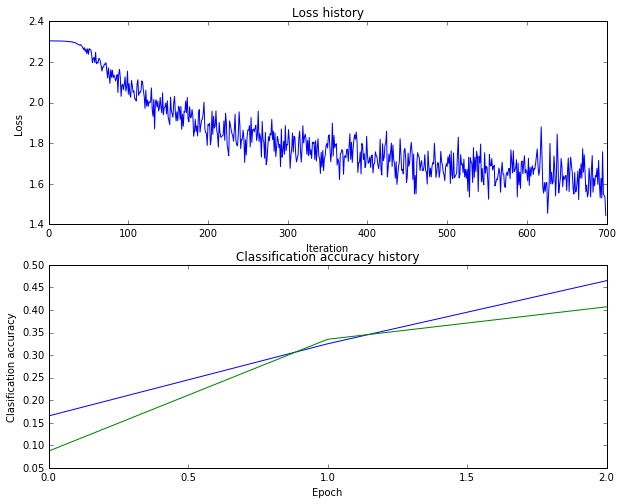

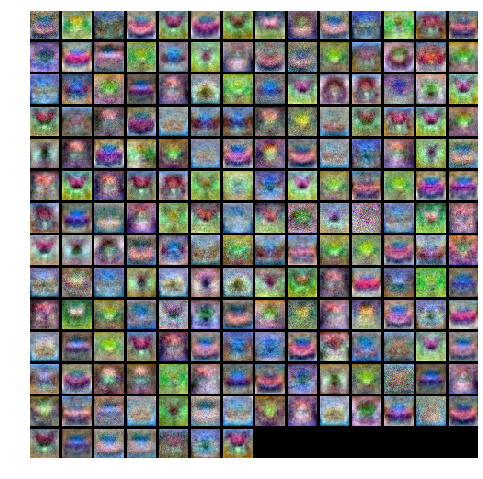


hidden_size:  189.323950471
learning_rate:  0.003
iteration 0 / 700: loss 2.304012
iteration 100 / 700: loss 1.785517
iteration 200 / 700: loss 1.649454
iteration 300 / 700: loss 1.772766
iteration 400 / 700: loss 1.681006
iteration 500 / 700: loss 2.059344
iteration 600 / 700: loss 1.581140


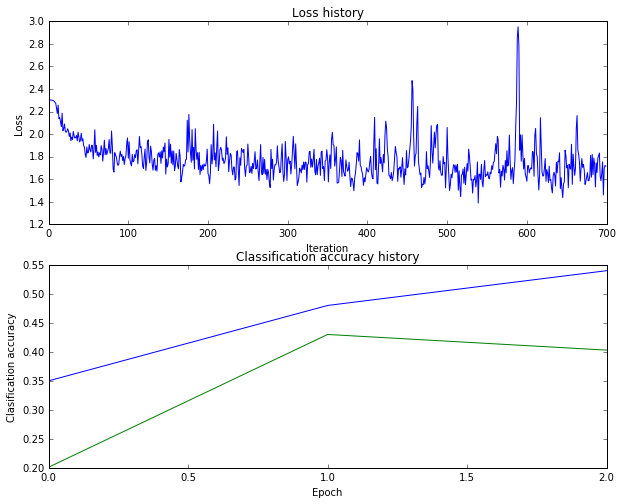

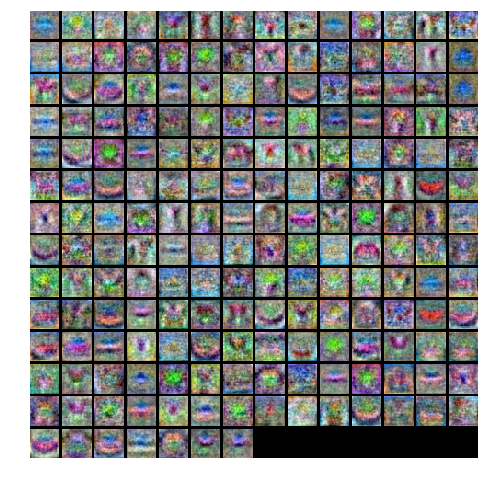


hidden_size:  264.097595025
learning_rate:  0.0001
iteration 0 / 700: loss 2.304567
iteration 100 / 700: loss 2.301777
iteration 200 / 700: loss 2.281056
iteration 300 / 700: loss 2.198917
iteration 400 / 700: loss 2.175098
iteration 500 / 700: loss 2.045245
iteration 600 / 700: loss 1.992739


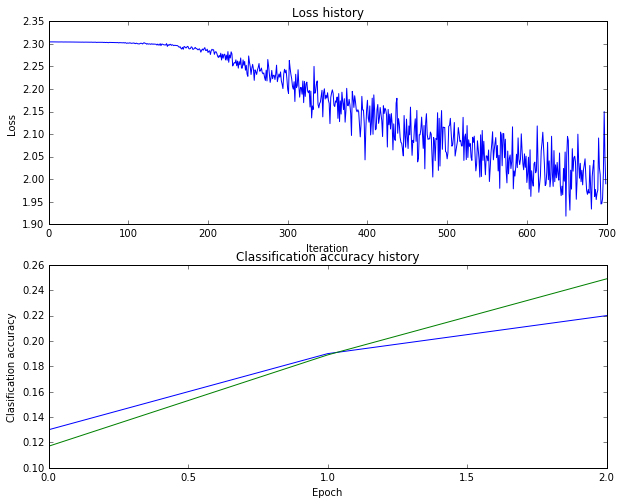

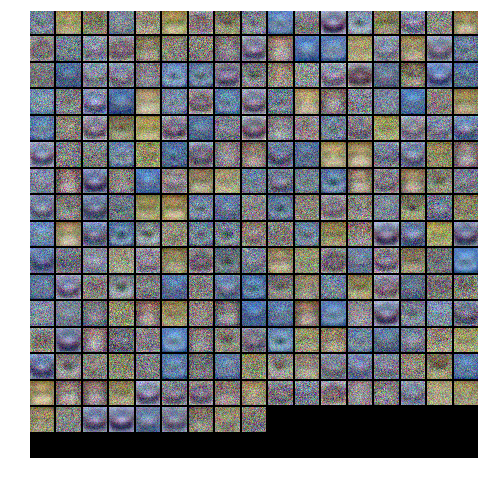


hidden_size:  264.097595025
learning_rate:  0.000547722557505
iteration 0 / 700: loss 2.304623
iteration 100 / 700: loss 2.057872
iteration 200 / 700: loss 1.884494
iteration 300 / 700: loss 1.760805
iteration 400 / 700: loss 1.655622
iteration 500 / 700: loss 1.671176
iteration 600 / 700: loss 1.726329


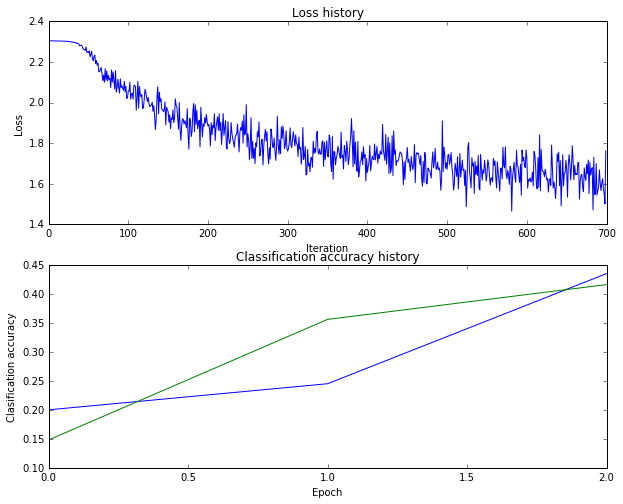

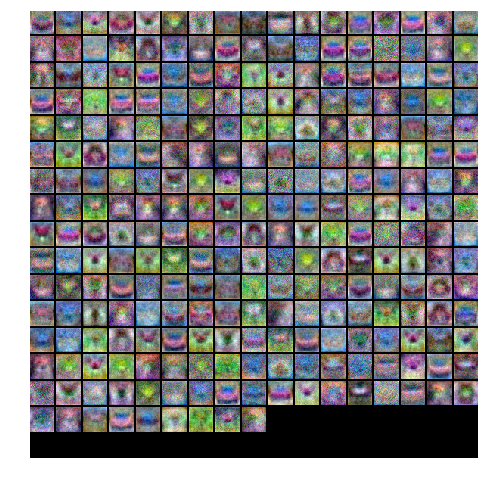


hidden_size:  264.097595025
learning_rate:  0.003
iteration 0 / 700: loss 2.304619
iteration 100 / 700: loss 1.917356
iteration 200 / 700: loss 2.084105
iteration 300 / 700: loss 1.897884
iteration 400 / 700: loss 1.783234
iteration 500 / 700: loss 1.791375
iteration 600 / 700: loss 1.577203


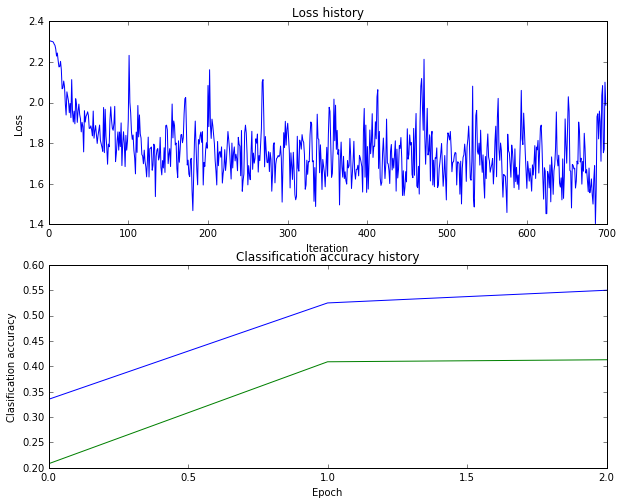

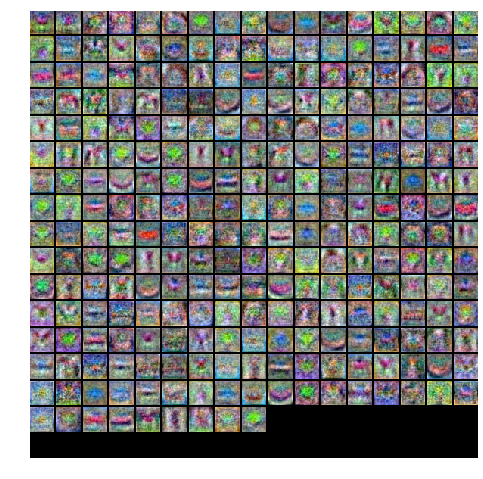


hidden_size:  368.403149864
learning_rate:  0.0001
iteration 0 / 700: loss 2.305437
iteration 100 / 700: loss 2.302828
iteration 200 / 700: loss 2.275482
iteration 300 / 700: loss 2.216210
iteration 400 / 700: loss 2.137243
iteration 500 / 700: loss 2.058154
iteration 600 / 700: loss 2.047290


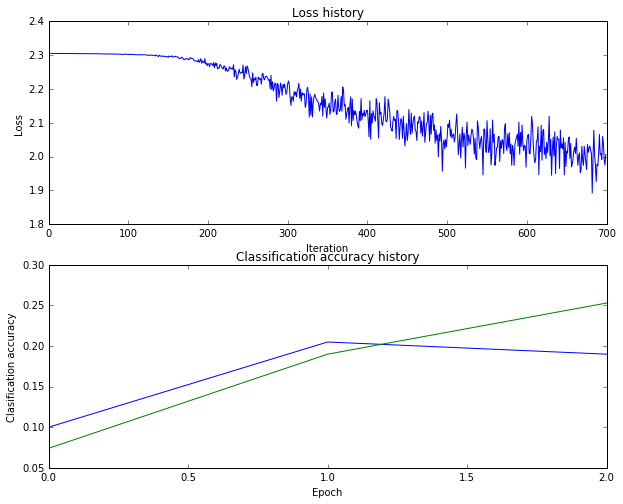

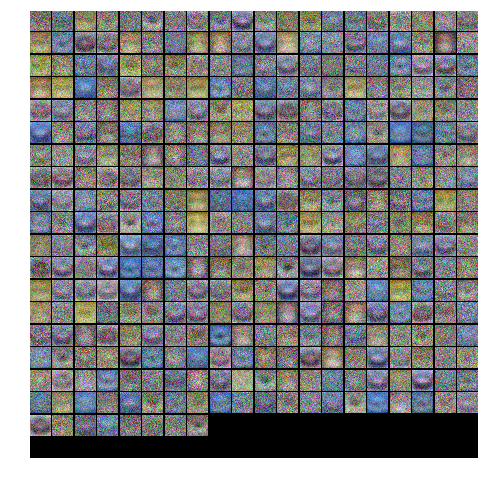


hidden_size:  368.403149864
learning_rate:  0.000547722557505
iteration 0 / 700: loss 2.305395
iteration 100 / 700: loss 2.074701
iteration 200 / 700: loss 1.891633
iteration 300 / 700: loss 1.741964
iteration 400 / 700: loss 1.761954
iteration 500 / 700: loss 1.574876
iteration 600 / 700: loss 1.715221


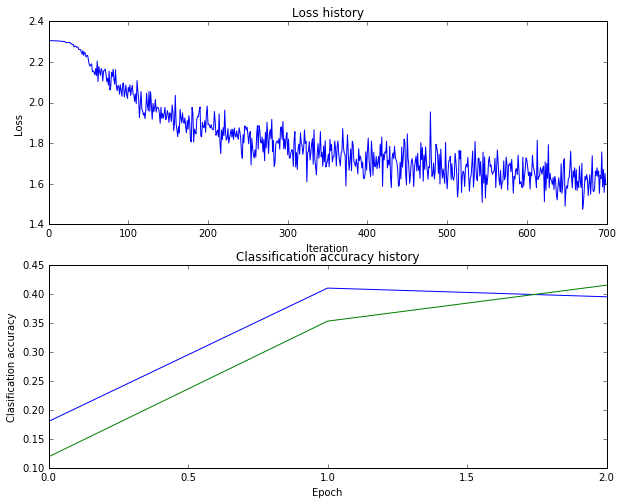

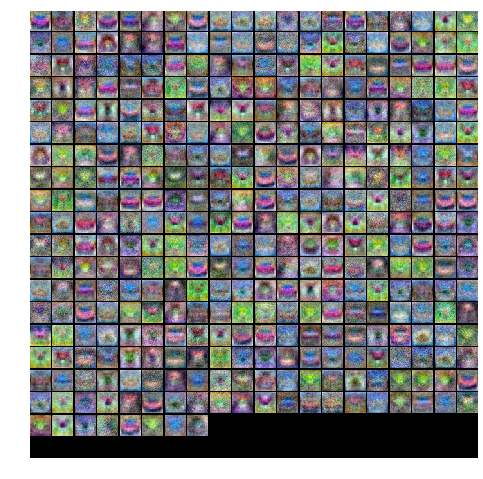


hidden_size:  368.403149864
learning_rate:  0.003
iteration 0 / 700: loss 2.305389
iteration 100 / 700: loss 1.749826
iteration 200 / 700: loss 1.768180
iteration 300 / 700: loss 1.758338
iteration 400 / 700: loss 2.153463
iteration 500 / 700: loss 1.941535
iteration 600 / 700: loss 1.582040


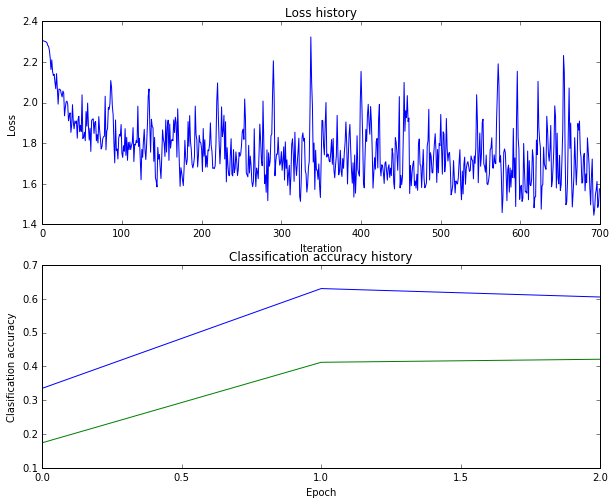

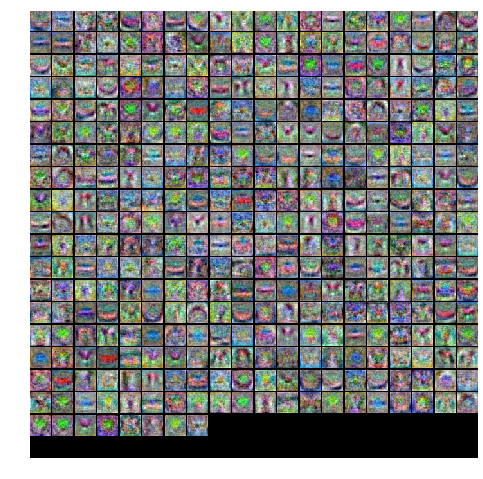


hidden_size:  513.904266401
learning_rate:  0.0001
iteration 0 / 700: loss 2.306485
iteration 100 / 700: loss 2.302151
iteration 200 / 700: loss 2.262972
iteration 300 / 700: loss 2.179421
iteration 400 / 700: loss 2.078416
iteration 500 / 700: loss 2.046484
iteration 600 / 700: loss 2.036049


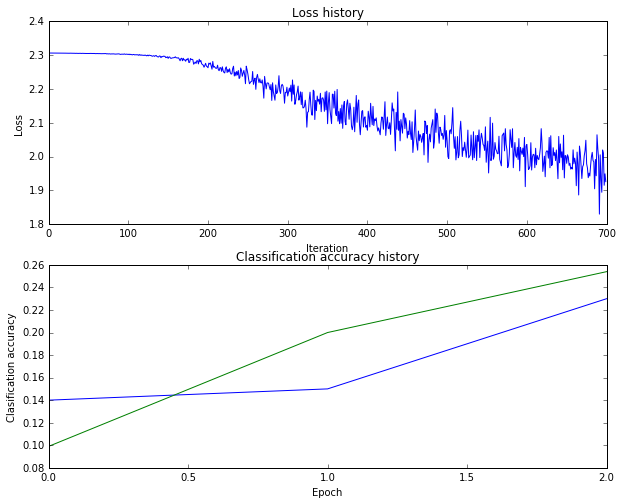

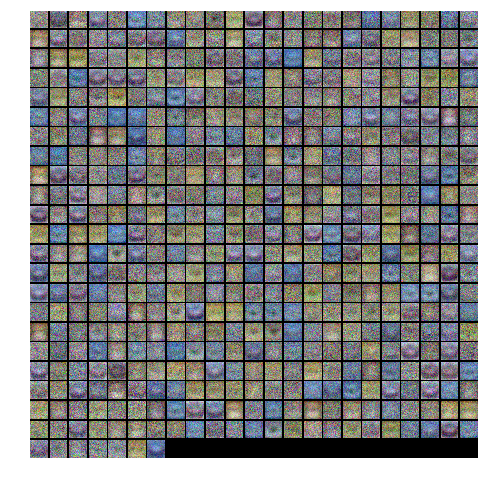


hidden_size:  513.904266401
learning_rate:  0.000547722557505
iteration 0 / 700: loss 2.306521
iteration 100 / 700: loss 2.013625
iteration 200 / 700: loss 1.791355
iteration 300 / 700: loss 1.676608
iteration 400 / 700: loss 1.672670
iteration 500 / 700: loss 1.594418
iteration 600 / 700: loss 1.534791


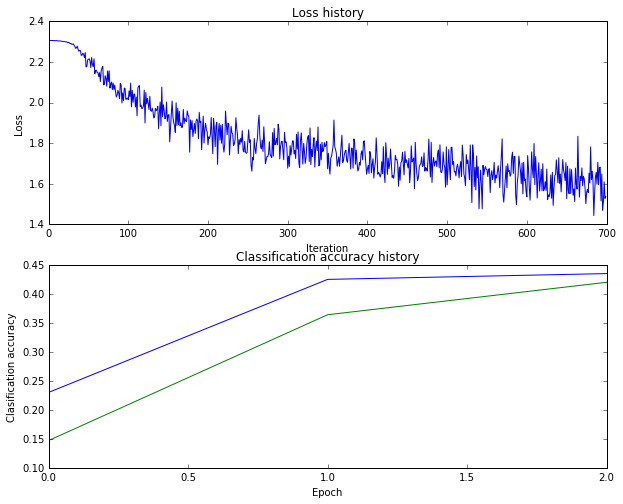

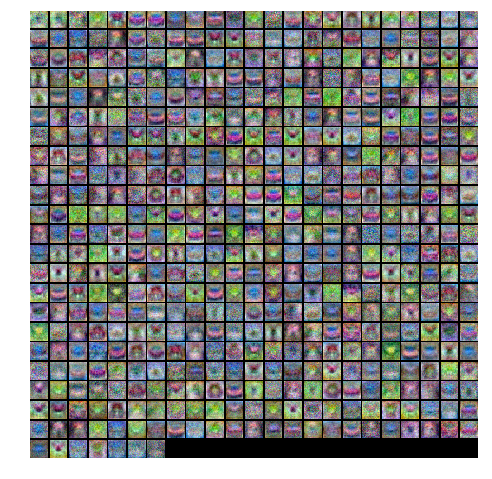


hidden_size:  513.904266401
learning_rate:  0.003
iteration 0 / 700: loss 2.306496
iteration 100 / 700: loss 1.866202
iteration 200 / 700: loss 1.732802
iteration 300 / 700: loss 1.661204
iteration 400 / 700: loss 1.899178
iteration 500 / 700: loss 1.664660
iteration 600 / 700: loss 1.541006


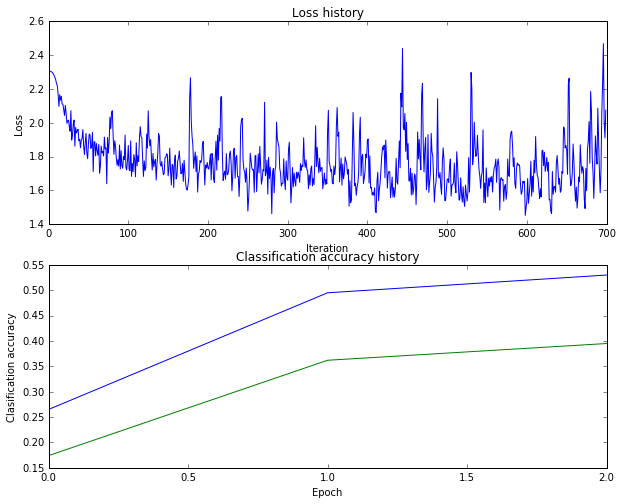

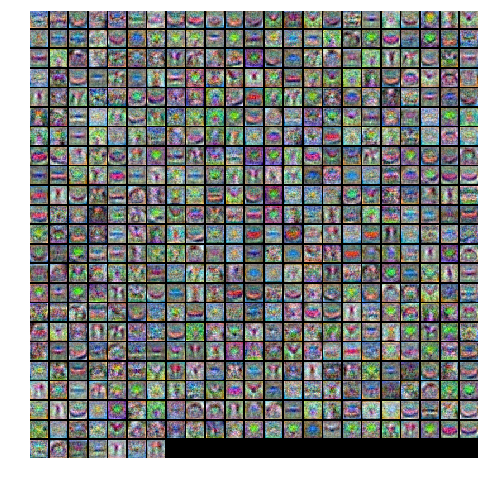


hidden_size:  716.871164437
learning_rate:  0.0001
iteration 0 / 700: loss 2.308115
iteration 100 / 700: loss 2.301517
iteration 200 / 700: loss 2.243608
iteration 300 / 700: loss 2.154208
iteration 400 / 700: loss 2.099517
iteration 500 / 700: loss 2.048825
iteration 600 / 700: loss 1.980894


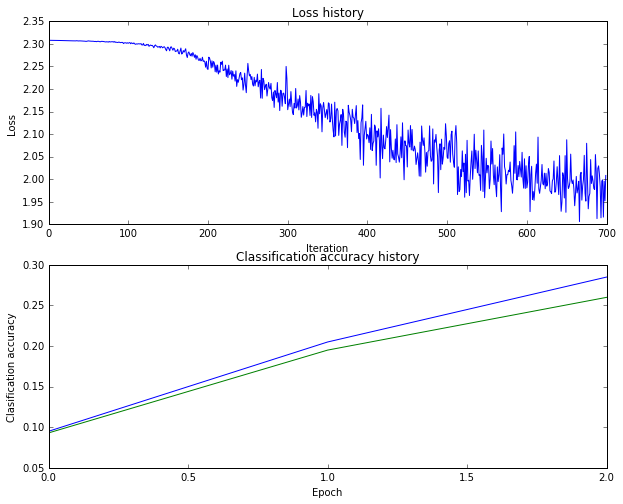

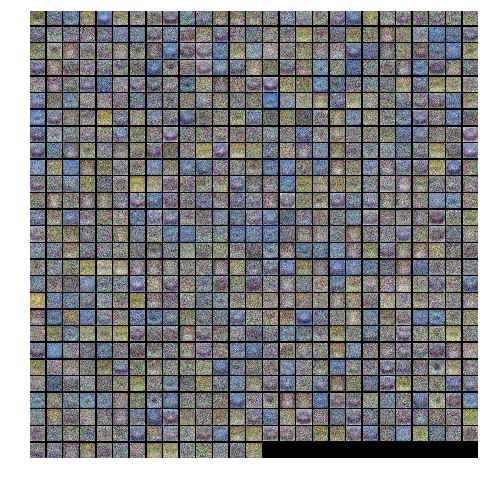


hidden_size:  716.871164437
learning_rate:  0.000547722557505
iteration 0 / 700: loss 2.307996
iteration 100 / 700: loss 2.022427
iteration 200 / 700: loss 1.867256
iteration 300 / 700: loss 1.718187
iteration 400 / 700: loss 1.647495
iteration 500 / 700: loss 1.674658
iteration 600 / 700: loss 1.478429


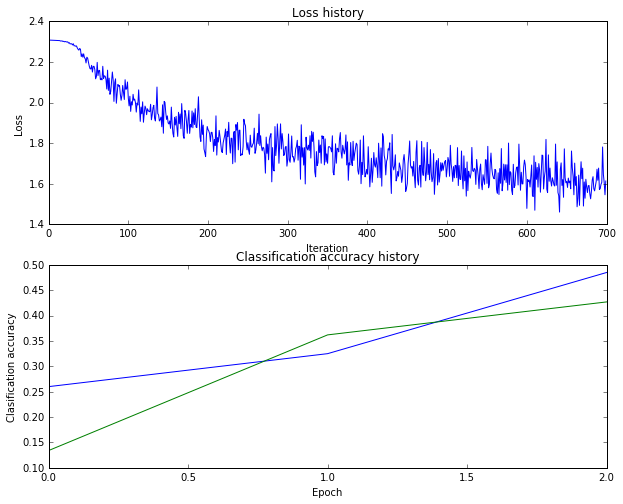

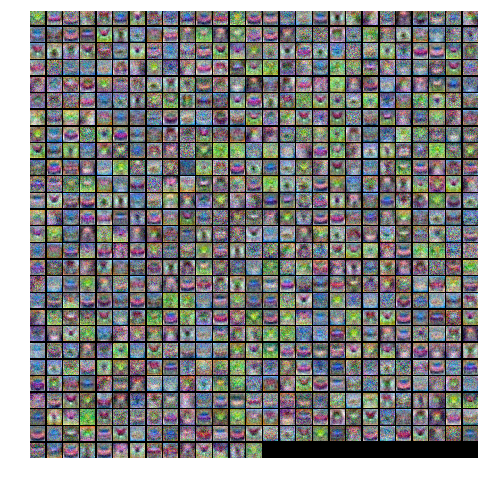


hidden_size:  716.871164437
learning_rate:  0.003
iteration 0 / 700: loss 2.308066
iteration 100 / 700: loss 1.902211
iteration 200 / 700: loss 1.572236
iteration 300 / 700: loss 1.837300
iteration 400 / 700: loss 1.585934
iteration 500 / 700: loss 1.741213
iteration 600 / 700: loss 1.567343


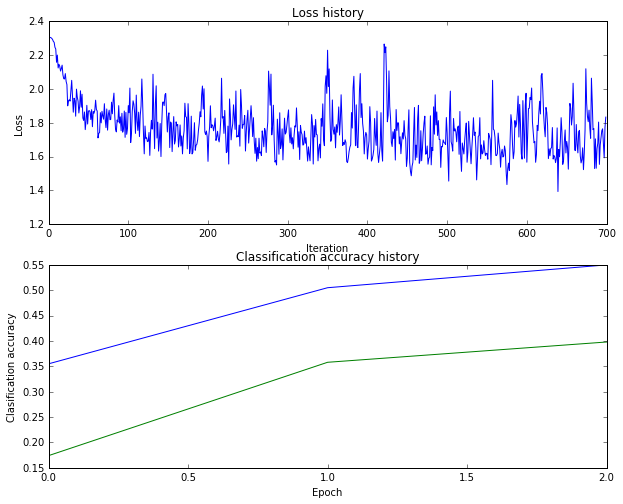

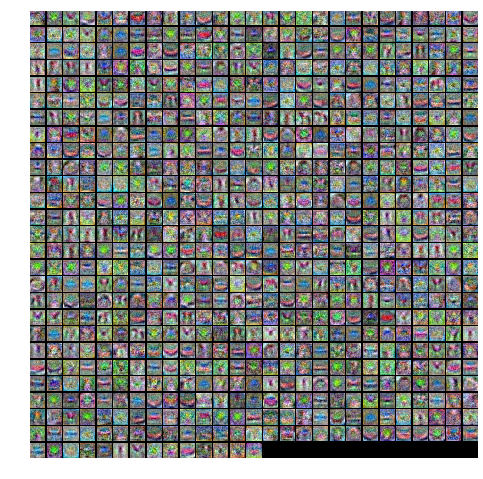


hidden_size:  1000.0
learning_rate:  0.0001
iteration 0 / 700: loss 2.310228
iteration 100 / 700: loss 2.301885
iteration 200 / 700: loss 2.263687
iteration 300 / 700: loss 2.133588
iteration 400 / 700: loss 2.096496
iteration 500 / 700: loss 2.043391
iteration 600 / 700: loss 2.093910


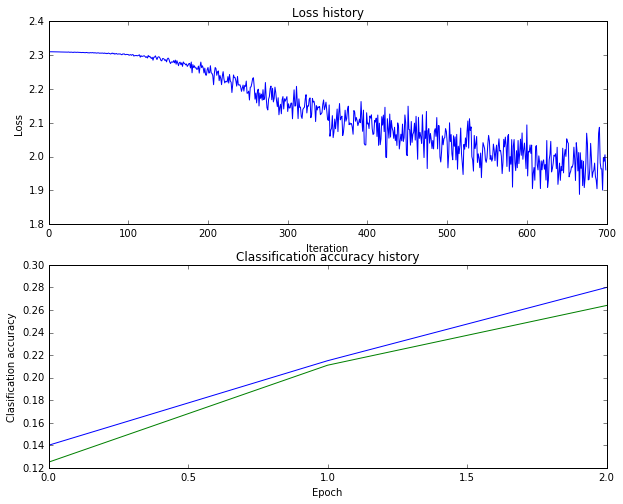

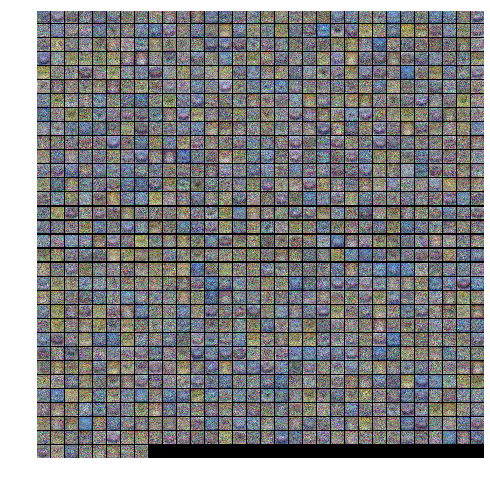


hidden_size:  1000.0
learning_rate:  0.000547722557505
iteration 0 / 700: loss 2.310317
iteration 100 / 700: loss 2.020292
iteration 200 / 700: loss 1.890752
iteration 300 / 700: loss 1.731968
iteration 400 / 700: loss 1.663875
iteration 500 / 700: loss 1.734079
iteration 600 / 700: loss 1.506508


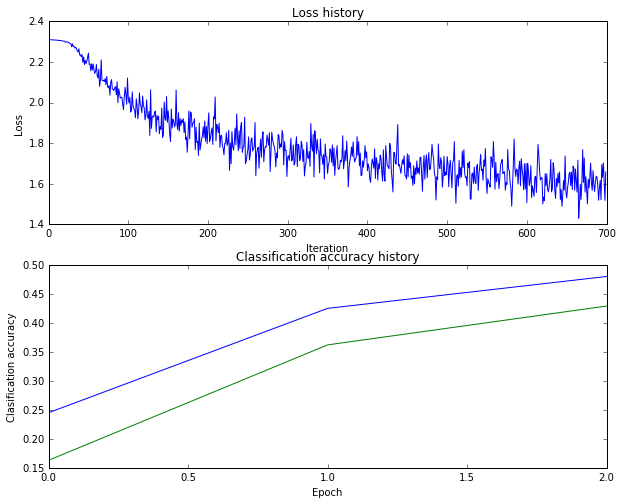

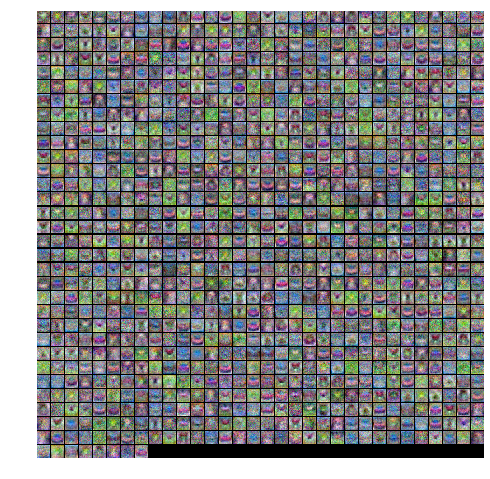


hidden_size:  1000.0
learning_rate:  0.003
iteration 0 / 700: loss 2.310116
iteration 100 / 700: loss 1.719699
iteration 200 / 700: loss 1.820178
iteration 300 / 700: loss 1.645272
iteration 400 / 700: loss 1.601223
iteration 500 / 700: loss 2.127443
iteration 600 / 700: loss 1.735028


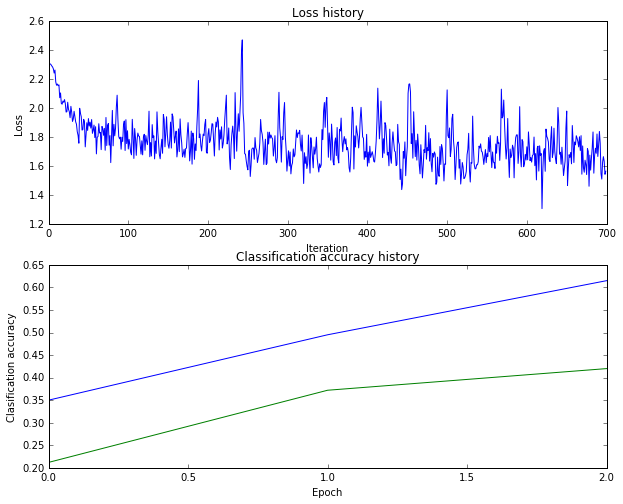

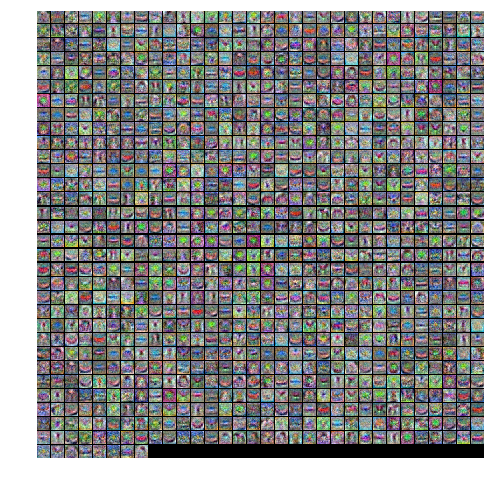


iteration 0 / 10000: loss 1.700775
iteration 100 / 10000: loss 1.961511
iteration 200 / 10000: loss 1.851442
iteration 300 / 10000: loss 1.655280
iteration 400 / 10000: loss 1.586505
iteration 500 / 10000: loss 1.807788
iteration 600 / 10000: loss 1.595495
iteration 700 / 10000: loss 1.625314
iteration 800 / 10000: loss 1.691879
iteration 900 / 10000: loss 1.519739
iteration 1000 / 10000: loss 1.580489
iteration 1100 / 10000: loss 1.600657
iteration 1200 / 10000: loss 1.930843
iteration 1300 / 10000: loss 1.883196
iteration 1400 / 10000: loss 1.471664
iteration 1500 / 10000: loss 1.508306
iteration 1600 / 10000: loss 1.512648
iteration 1700 / 10000: loss 1.763605
iteration 1800 / 10000: loss 1.389570
iteration 1900 / 10000: loss 1.491075
iteration 2000 / 10000: loss 1.362354
iteration 2100 / 10000: loss 1.406423
iteration 2200 / 10000: loss 1.567710
iteration 2300 / 10000: loss 1.567861
iteration 2400 / 10000: loss 1.555749
iteration 2500 / 10000: loss 1.455983
iteration 2600 / 10000:

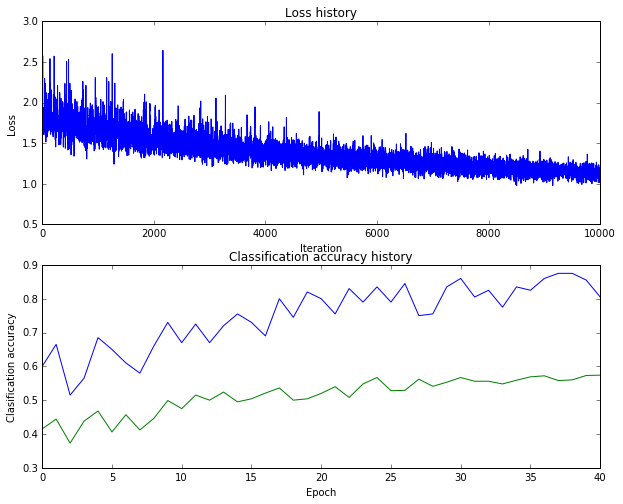

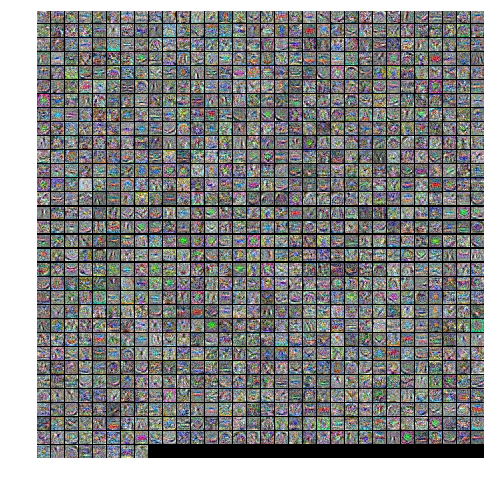

In [29]:
best_net = None # store the best model into this 

#################################################################################
# TODO: Tune hyperparameters using the validation set. Store your best trained  #
# model in best_net.                                                            #
#                                                                               #
# To help debug your network, it may help to use visualizations similar to the  #
# ones we used above; these visualizations will have significant qualitative    #
# differences from the ones we saw above for the poorly tuned network.          #
#                                                                               #
# Tweaking hyperparameters by hand can be fun, but you might find it useful to  #
# write code to sweep through possible combinations of hyperparameters          #
# automatically like we did on the previous exercises.                          #
#################################################################################
input_size = 32 * 32 * 3
num_classes = 10
best_val = -1
best_hidden_size = None
best_learning_rate = None
for hidden_size in np.logspace(np.log10(50), np.log10(1000), 10):
    for learning_rate in np.logspace(np.log10(1e-4), np.log10(3e-3), 3):
        net = TwoLayerNet(input_size, hidden_size, num_classes)
        print("hidden_size: ", hidden_size)
        print("learning_rate: ", learning_rate)
        stats = net.train(X_train, y_train, X_val, y_val,
                          num_iters=700, batch_size=200,
                          learning_rate=learning_rate, learning_rate_decay=0.95,
                          reg=0.5, verbose=True)
        y_train_pred = net.predict(X_train)
        train_accuracy = np.mean(y_train == y_train_pred)
        y_val_pred = net.predict(X_val)
        val_accuracy = np.mean(y_val == y_val_pred)
        plt.subplot(2, 1, 1)
        plt.plot(stats['loss_history'])
        plt.title('Loss history')
        plt.xlabel('Iteration')
        plt.ylabel('Loss')

        plt.subplot(2, 1, 2)
        plt.plot(stats['train_acc_history'], label='train')
        plt.plot(stats['val_acc_history'], label='val')
        plt.title('Classification accuracy history')
        plt.xlabel('Epoch')
        plt.ylabel('Clasification accuracy')
        plt.show()
        show_net_weights(net)
        print()
        if val_accuracy > best_val:
            best_net = net
            best_learning_rate = learning_rate
            best_hidden_size = hidden_size

print("best hidden_size: ", best_net.hidden_size)
print("best learning_rate: ", best_net.learning_rate)
stats = best_net.train(X_train, y_train, X_val, y_val,
                       num_iters=10000, batch_size=200,
                       learning_rate=learning_rate, learning_rate_decay=0.95,
                       reg=0.5, verbose=True)
y_train_pred = best_net.predict(X_train)
train_accuracy = np.mean(y_train == y_train_pred)
y_val_pred = best_net.predict(X_val)
val_accuracy = np.mean(y_val == y_val_pred)
plt.subplot(2, 1, 1)
plt.plot(stats['loss_history'])
plt.title('Loss history')
plt.xlabel('Iteration')
plt.ylabel('Loss')

plt.subplot(2, 1, 2)
plt.plot(stats['train_acc_history'], label='train')
plt.plot(stats['val_acc_history'], label='val')
plt.title('Classification accuracy history')
plt.xlabel('Epoch')
plt.ylabel('Clasification accuracy')
plt.show()
show_net_weights(net)

#################################################################################
#                               END OF YOUR CODE                                #
#################################################################################

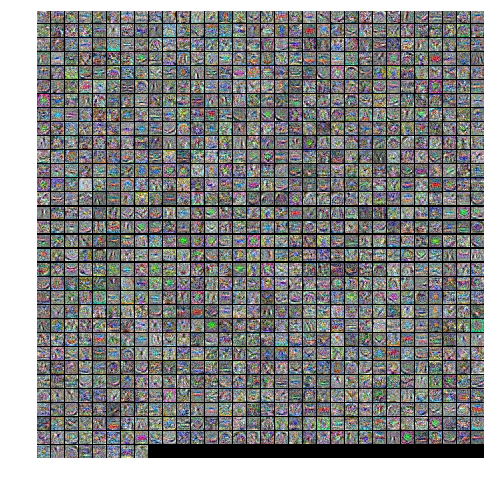

In [30]:
# visualize the weights of the best network
show_net_weights(best_net)

# Run on the test set
When you are done experimenting, you should evaluate your final trained network on the test set; you should get above 48%.

**We will give you extra bonus point for every 1% of accuracy above 52%.**

In [31]:
test_acc = (best_net.predict(X_test) == y_test).mean()
print('Test accuracy: ', test_acc)

Test accuracy:  0.565
